In [2]:
import numpy as np
import pandas as pd 
import matplotlib
import matplotlib.pyplot as plt
import seaborn as sns
from pylab import rcParams
import glob
import os

%matplotlib inline

### Question 2: How Does the Riding Demand Depend on the Local Weather?
- Unlike cars, weather conditions like raining or snowing has a very detrimental effect on the bicycle demand.
- In studying the time series of daily rider counts of NYC/Jersey city, your team should have noticed the annual seasonality
that the demand drop annually w.r.t. cold weather.
- Verify or modify your hypothesis based on the local hourly weather information from **noaa**
https://www.ncei.noaa.gov/data/global-hourly/archive/csv/. Analyze the dependence of riding demand on temperature, rain/snow condition.
- The raw ride count might not be the objective gauge of riders' willingness. It also depends on the supply (the fleet count and docking station coun     t).
- Normalize raw ride counts by the effective fleet in circulation to gain a more objective barometer. 

### DA Question 4: Comparative Study on Bike Sharing Systems in U.S./Canada 

- Dockless shared-bike data is hard to come by. Only when an shared-bike operator can monopolize, there is no incentive
to open their system ride data. After all, dockless systems have difficulty to survive in a tight regulartory environment.
- An angle to study bike sharing more systematically is to study the system data from different cities. By comparing
their similarities and differences, the company can learn the universal as well the idosyncratic components of rider behaviors.
- This will play a vital role to migrate the developed shared-bike system to new cities/new countries, or to learn from the competing
companies.

- In U.S. and Canada, New York city, Chicago, Washington DC, Miami, San Francisco and the other cities offer docked shared bikes.
- In Canada, Montreal and Vancouver have shared bike systems. 

- Do a comparative study on these distinct bike sharing systems (some are operated by the same company). 
- What common insights you can provide for all these systems? How are different systems different from each other?
- Can you explain their differences in terms of the differences on regulations, geography and public transportation infra-structures?



In [507]:
sampled2.shape

(1838885, 23)

In [5]:
sampled2 = pd.read_csv('../citibike_data/sampled_trip_history2.csv')

/Users/Tyler/anaconda3/lib/python3.7/site-packages/IPython/core/interactiveshell.py:3063: DtypeWarning: Columns (13) have mixed types.Specify dtype option on import or set low_memory=False.
  interactivity=interactivity, compiler=compiler, result=result)


In [8]:
sampled2.head()

,tripduration,starttime,stoptime,startstationid,startstationname,startstationlatitude,startstationlongitude,endstationid,endstationname,endstationlatitude,endstationlongitude,bikeid,usertype,birthyear,gender
0,671,2017-09-25 13:59:44,2017-09-25 14:10:56,341.0,Stanton St & Mangin St,40.717821,-73.976289,82.0,St James Pl & Pearl St,40.711174,-74.000165,29021,Subscriber,1980,2
1,763,2017-09-11 08:14:44,2017-09-11 08:27:27,403.0,E 2 St & 2 Ave,40.725029,-73.990697,2010.0,Grand St & Greene St,40.721655,-74.002347,29719,Subscriber,1966,2
2,908,2017-09-01 12:37:12,2017-09-01 12:52:21,359.0,E 47 St & Park Ave,40.755103,-73.974987,428.0,E 3 St & 1 Ave,40.724677,-73.987834,16583,Subscriber,1986,1
3,370,2017-09-05 19:35:46,2017-09-05 19:41:56,3076.0,Scholes St & Manhattan Ave,40.708704,-73.944862,3068.0,Humboldt St & Varet St,40.703172,-73.940636,26667,Customer,NaN,0
4,871,2017-09-26 09:10:07,2017-09-26 09:24:39,487.0,E 20 St & FDR Drive,40.733143,-73.975739,486.0,Broadway & W 29 St,40.746201,-73.988557,28812,Subscriber,1984,2


## Ridership Data

In [6]:
ridership2 = pd.read_csv('../citibike_data/cleaned_ridership2.csv')

In [9]:
ridership2.head()

,date,tripsoverthepast24-hours(midnightto1159pm),milestraveledtoday(midnightto1159pm),24-hourpassespurchased(midnightto1159pm),3-daypassespurchased(midnightto1159pm),cumulativetrips(sincelaunch),milestraveledtodate,annualmembersign-ups(midnightto1159pm),7-daypassespurchased(midnightto1159pm),totalannualmembers_combined
0,4/1/18,33148,94040.0,2363,264.0,NaN,NaN,NaN,NaN,257811.0
1,4/2/18,22062,50418.0,297,20.0,NaN,NaN,NaN,NaN,257889.0
2,4/3/18,25883,59477.0,189,21.0,NaN,NaN,NaN,NaN,257942.0
3,4/4/18,36755,80049.0,611,48.0,NaN,NaN,NaN,NaN,258025.0
4,4/5/18,39814,87382.0,972,112.0,NaN,NaN,NaN,NaN,258086.0


## Seasonality

In [10]:
from statsmodels.tsa.seasonal import seasonal_decompose
import datetime as dt

In [12]:
sampled2.head()

,tripduration,starttime,stoptime,startstationid,startstationname,startstationlatitude,startstationlongitude,endstationid,endstationname,endstationlatitude,endstationlongitude,bikeid,usertype,birthyear,gender
0,671,2017-09-25 13:59:44,2017-09-25 14:10:56,341.0,Stanton St & Mangin St,40.717821,-73.976289,82.0,St James Pl & Pearl St,40.711174,-74.000165,29021,Subscriber,1980,2
1,763,2017-09-11 08:14:44,2017-09-11 08:27:27,403.0,E 2 St & 2 Ave,40.725029,-73.990697,2010.0,Grand St & Greene St,40.721655,-74.002347,29719,Subscriber,1966,2
2,908,2017-09-01 12:37:12,2017-09-01 12:52:21,359.0,E 47 St & Park Ave,40.755103,-73.974987,428.0,E 3 St & 1 Ave,40.724677,-73.987834,16583,Subscriber,1986,1
3,370,2017-09-05 19:35:46,2017-09-05 19:41:56,3076.0,Scholes St & Manhattan Ave,40.708704,-73.944862,3068.0,Humboldt St & Varet St,40.703172,-73.940636,26667,Customer,NaN,0
4,871,2017-09-26 09:10:07,2017-09-26 09:24:39,487.0,E 20 St & FDR Drive,40.733143,-73.975739,486.0,Broadway & W 29 St,40.746201,-73.988557,28812,Subscriber,1984,2


In [13]:
sampled2['startdate'] = pd.to_datetime(sampled2.starttime).dt.strftime('%Y-%m-%d')

sampled2['starttime2'] = pd.to_datetime(sampled2.starttime).dt.strftime('%H:%M:%S')

sampled2['stopdate'] = pd.to_datetime(sampled2.stoptime).dt.strftime('%Y-%m-%d')

sampled2['stoptime2'] = pd.to_datetime(sampled2.stoptime).dt.strftime('%H:%M:%S')

In [14]:
season_test = sampled2.copy().set_index('startdate')

In [15]:
season_test.head()

,tripduration,starttime,stoptime,startstationid,startstationname,startstationlatitude,startstationlongitude,endstationid,endstationname,endstationlatitude,endstationlongitude,bikeid,usertype,birthyear,gender,starttime2,stopdate,stoptime2
startdate,,,,,,,,,,,,,,,,,,
2017-09-25,671,2017-09-25 13:59:44,2017-09-25 14:10:56,341.0,Stanton St & Mangin St,40.717821,-73.976289,82.0,St James Pl & Pearl St,40.711174,-74.000165,29021,Subscriber,1980,2,13:59:44,2017-09-25,14:10:56
2017-09-11,763,2017-09-11 08:14:44,2017-09-11 08:27:27,403.0,E 2 St & 2 Ave,40.725029,-73.990697,2010.0,Grand St & Greene St,40.721655,-74.002347,29719,Subscriber,1966,2,08:14:44,2017-09-11,08:27:27
2017-09-01,908,2017-09-01 12:37:12,2017-09-01 12:52:21,359.0,E 47 St & Park Ave,40.755103,-73.974987,428.0,E 3 St & 1 Ave,40.724677,-73.987834,16583,Subscriber,1986,1,12:37:12,2017-09-01,12:52:21
2017-09-05,370,2017-09-05 19:35:46,2017-09-05 19:41:56,3076.0,Scholes St & Manhattan Ave,40.708704,-73.944862,3068.0,Humboldt St & Varet St,40.703172,-73.940636,26667,Customer,NaN,0,19:35:46,2017-09-05,19:41:56
2017-09-26,871,2017-09-26 09:10:07,2017-09-26 09:24:39,487.0,E 20 St & FDR Drive,40.733143,-73.975739,486.0,Broadway & W 29 St,40.746201,-73.988557,28812,Subscriber,1984,2,09:10:07,2017-09-26,09:24:39


In [16]:
np.sum(season_test.isnull())

tripduration                 0
starttime                    0
stoptime                     0
startstationid              46
startstationname            46
startstationlatitude         0
startstationlongitude        0
endstationid               409
endstationname             409
endstationlatitude         363
endstationlongitude        363
bikeid                       0
usertype                   959
birthyear                99422
gender                       0
starttime2                   0
stopdate                     0
stoptime2                    0
dtype: int64

In [17]:
season_test['bike_trip'] = 1

In [500]:
sampled2.gender = sampled2.gender.apply(lambda x: 'Unknown' if x == 0 else ( 'Male' if x == 1 else 'Female')) 


In [18]:
season_test.groupby([season_test.index]).count()

,tripduration,starttime,stoptime,startstationid,startstationname,startstationlatitude,startstationlongitude,endstationid,endstationname,endstationlatitude,endstationlongitude,bikeid,usertype,birthyear,gender,starttime2,stopdate,stoptime2,bike_trip
startdate,,,,,,,,,,,,,,,,,,,
2013-06-01,161,161,161,161,161,161,161,156,156,156,156,161,161,91,161,161,161,161,161
2013-06-02,299,299,299,299,299,299,299,292,292,292,292,299,299,99,299,299,299,299,299
2013-06-03,128,128,128,128,128,128,128,123,123,123,123,128,128,82,128,128,128,128,128
2013-06-04,300,300,300,300,300,300,300,286,286,286,286,300,300,162,300,300,300,300,300
2013-06-05,319,319,319,319,319,319,319,309,309,309,309,319,319,173,319,319,319,319,319
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
2019-12-27,648,648,648,648,648,648,648,648,648,648,648,648,648,648,648,648,648,648,648
2019-12-28,567,567,567,567,567,567,567,567,567,567,567,567,567,567,567,567,567,567,567
2019-12-29,350,350,350,350,350,350,350,350,350,350,350,350,350,350,350,350,350,350,350


(array([-500.,    0.,  500., 1000., 1500., 2000., 2500., 3000.]),
 <a list of 8 Text xticklabel objects>)

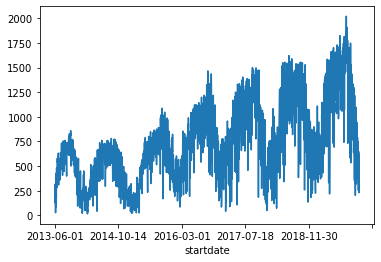

In [19]:
season_test.groupby([season_test.index])['bike_trip'].sum().plot()
plt.xticks()

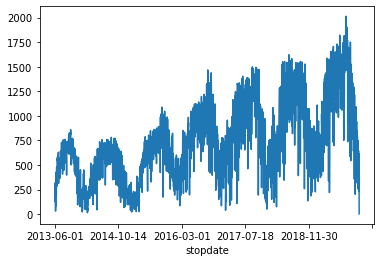

In [20]:
season_test.groupby(['stopdate'])['bike_trip'].sum().plot()

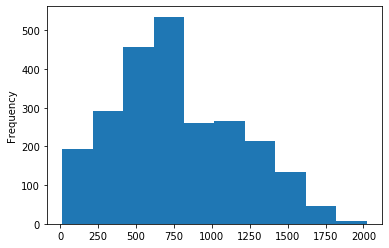

In [21]:
season_test.groupby([season_test.index])['bike_trip'].sum().plot.hist(30)

In [22]:
season_trips_transform = season_test.groupby([season_test.index])['bike_trip'].sum()

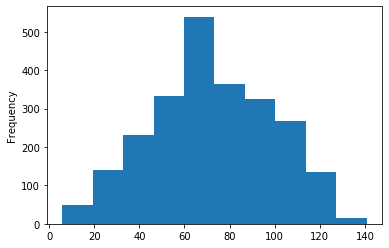

In [23]:
(season_trips_transform**.65).plot.hist(30)

In [24]:
season_dt = season_test[['bike_trip']]
dt_group = season_dt.groupby(season_dt.index)['bike_trip'].sum()

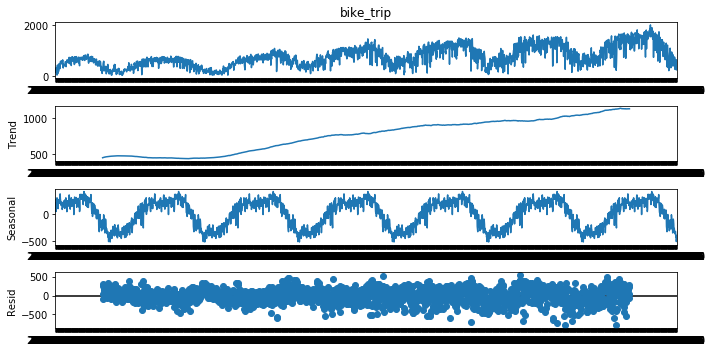

In [25]:
# from pylab import rcParams
rcParams['figure.figsize'] = 10, 5


start_season = seasonal_decompose(dt_group, model = 'additive', period = 365)

start_season.plot()

plt.show()

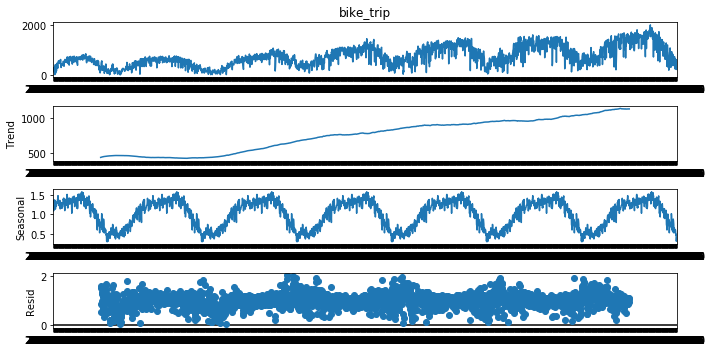

In [26]:
rcParams['figure.figsize'] = 10, 5

start_season = seasonal_decompose(dt_group, model = 'multiplicative', period = 365)

start_season.plot()

plt.show()

In [33]:
np.arange(0, 60, 12)

array([ 0, 12, 24, 36, 48])

Text(0.5, 1.0, 'Bike trip seasonality')

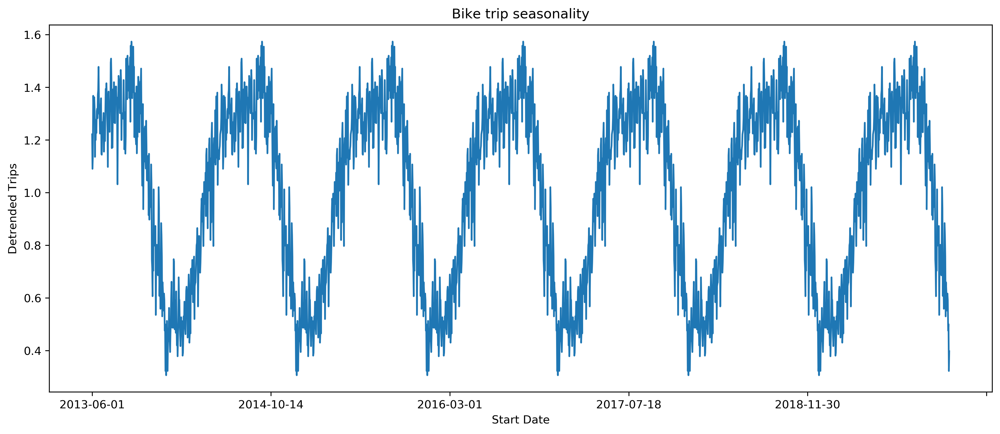

In [643]:
rcParams['figure.dpi'] = 300

start_season.seasonal.plot()
plt.ylabel('Detrended Trips')
plt.xlabel('Start Date')
plt.title('Bike trip seasonality')

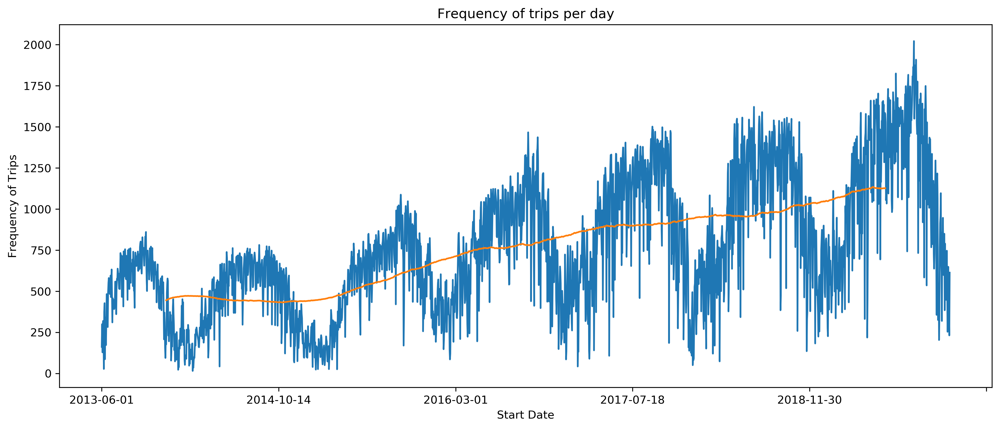

In [640]:
rcParams['figure.dpi'] = 300

start_season.observed.plot()
start_season.trend.plot()
plt.xticks()
plt.xlabel('Start Date')
plt.ylabel('Frequency of Trips')
plt.title('Frequency of trips per day')
plt.show()


## Central Park Weather

Central Park weather data was obtained from the National Centers for Environmenal Information (NCEI) within the  National Oceanic and Atmospheric Administration (NOAA). The data consists of daily summaries including wind, precipation, and the minimum and maximum daily temperatures. 

To confirm the dates of the weather data, the minimum date from trip history was June 1, 2013 and the max date was December 31, 2019.

In [40]:
min(sampled2.startdate)

'2013-06-01'

In [41]:
max(sampled2.startdate)

'2019-12-31'

- AWND = Average daily wind speed (meters per second or miles per hour as per user preference)
- PRCP = Precipitation (mm or inches as per user preference, inches to hundredths on Daily Form pdf file) 
- SNOW = Snowfall (mm or inches as per user preference, inches to tenths on Daily Form pdf file)
- SNWD = Snow depth (mm or inches as per user preference, inches on Daily Form pdf file)
- average of hourly temperature values (TAVG)
- TMAX = Maximum temperature (Fahrenheit or Celsius as per user preference, Fahrenheit to tenths on Daily Form pdf file
- TMIN = Minimum temperature (Fahrenheit or Celsius as per user preference, Fahrenheit to tenths on Daily Form pdf file
- TSUN = Daily total sunshine (minutes)
- weather type:
    - 01 = Fog, ice fog, or freezing fog (may include heavy fog) 
    - 02 = Heavy fog or heaving freezing fog (not always distinguished from fog) 
    - 03 = Thunder
    - 04 = Ice pellets, sleet, snow pellets, or small hail
    - 06 = Glaze or rime 
    - 08 = Smoke or haze

In [44]:
cpw = pd.read_csv('../citibike_data/cpw.csv', sep = ',')
cpw.columns = map(str.lower, cpw.columns)
cpw.head()

,station,name,latitude,longitude,elevation,date,awnd,prcp,snow,snwd,tavg,tmax,tmin,tsun,wt01,wt02,wt03,wt04,wt06,wt08
0,USW00094728,"NY CITY CENTRAL PARK, NY US",40.77898,-73.96925,42.7,2013-06-01,3.80,0.00,0.0,0.0,NaN,90,73,NaN,NaN,NaN,NaN,NaN,NaN,NaN
1,USW00094728,"NY CITY CENTRAL PARK, NY US",40.77898,-73.96925,42.7,2013-06-02,6.04,0.85,0.0,0.0,NaN,88,69,NaN,1.0,NaN,NaN,NaN,NaN,NaN
2,USW00094728,"NY CITY CENTRAL PARK, NY US",40.77898,-73.96925,42.7,2013-06-03,3.36,0.87,0.0,0.0,NaN,78,66,NaN,1.0,NaN,NaN,NaN,NaN,NaN
3,USW00094728,"NY CITY CENTRAL PARK, NY US",40.77898,-73.96925,42.7,2013-06-04,4.92,0.00,0.0,0.0,NaN,75,57,NaN,NaN,NaN,NaN,NaN,NaN,NaN
4,USW00094728,"NY CITY CENTRAL PARK, NY US",40.77898,-73.96925,42.7,2013-06-05,3.80,0.00,0.0,0.0,NaN,74,58,NaN,NaN,NaN,NaN,NaN,NaN,NaN


In [45]:
cpw_date = cpw.copy()
cpw_date.date = pd.to_datetime(cpw_date.date)

Confirming the dates of the weather data:

In [510]:
min(cpw.date)

'2013-06-01'

In [511]:
max(cpw.date)

'2019-12-31'

In [46]:
cpw_date.dtypes

station              object
name                 object
latitude            float64
longitude           float64
elevation           float64
date         datetime64[ns]
awnd                float64
prcp                float64
snow                float64
snwd                float64
tavg                float64
tmax                  int64
tmin                  int64
tsun                float64
wt01                float64
wt02                float64
wt03                float64
wt04                float64
wt06                float64
wt08                float64
dtype: object

In [47]:
np.sum(cpw_date.isnull())

station         0
name            0
latitude        0
longitude       0
elevation       0
date            0
awnd          166
prcp            0
snow            1
snwd            0
tavg         2405
tmax            0
tmin            0
tsun         2404
wt01         1584
wt02         2359
wt03         2350
wt04         2400
wt06         2391
wt08         1955
dtype: int64

Checks for missing data or data not received indicated by the documentation

In [48]:
print('NA in prcp:', np.sum(cpw['prcp'] == 9999))
print('NA in snow:', np.sum(cpw['snow'] == 9999))
print('NA in snwd:', np.sum(cpw['snwd'] == 9999))
print('NA in tmax:', np.sum(cpw['tmax'] == 9999))
print('NA in tmin:', np.sum(cpw['tmin'] == 9999))

NA in prcp: 0
NA in snow: 0
NA in snwd: 0
NA in tmax: 0
NA in tmin: 0


Text(0.5, 1.0, 'Minimum and maximum temperatures by day')

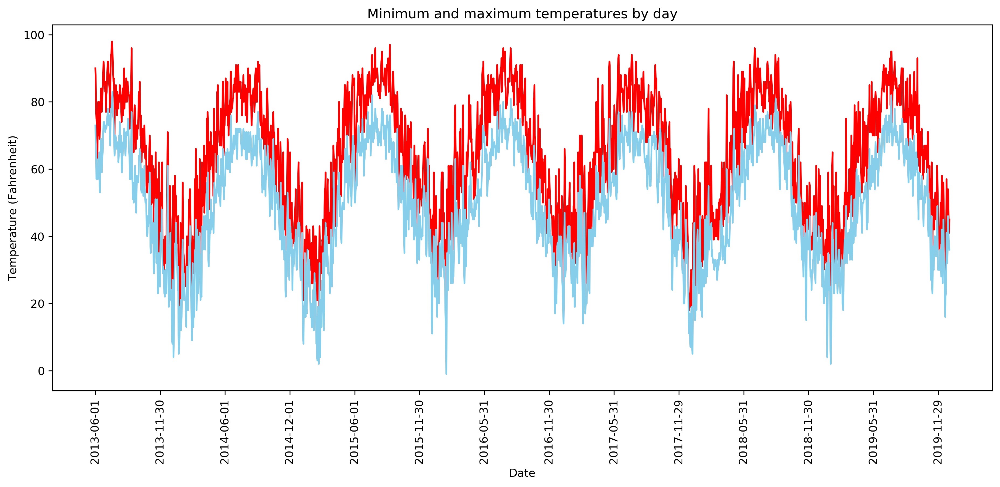

In [635]:
rcParams['figure.dpi'] = 300
rcParams['figure.figsize'] = 15, 6

plt.plot('date', 'tmax', data = cpw, color = 'red',)
plt.plot('date', 'tmin', data = cpw, color = 'skyblue')
plt.xlabel('Date')
plt.ylabel('Temperature (Fahrenheit)')
plt.xticks(np.arange(0, 2406, 182.5), rotation = 90)
plt.title('Minimum and maximum temperatures by day')

In [50]:
cpw_month = cpw_date.set_index('date').groupby(pd.Grouper(freq='M'))

In [51]:
avg_temp = cpw_month[['tmax', 'tmin']].agg('mean')

In [52]:
import matplotlib.dates as mdates

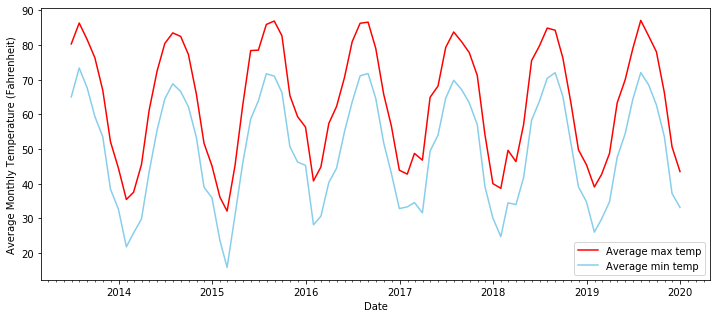

In [53]:
years = mdates.YearLocator()   # every year
months = mdates.MonthLocator()  # every month
years_fmt = mdates.DateFormatter('%Y')

# the plot
fig, ax= plt.subplots(figsize = (12, 5))
ax.plot('tmax', data = avg_temp, color = 'red')
ax.plot('tmin', data = avg_temp, color = 'skyblue')

#axis & legend labels
plt.xlabel('Date')
plt.ylabel('Average Monthly Temperature (Fahrenheit)')
plt.legend(loc = 4, labels = ['Average max temp', 'Average min temp'])

ax.xaxis.set_major_locator(years)
ax.xaxis.set_major_formatter(years_fmt)
ax.xaxis.set_minor_locator(months)

plt.show()

In [54]:
season_test.head()

,tripduration,starttime,stoptime,startstationid,startstationname,startstationlatitude,startstationlongitude,endstationid,endstationname,endstationlatitude,endstationlongitude,bikeid,usertype,birthyear,gender,starttime2,stopdate,stoptime2,bike_trip
startdate,,,,,,,,,,,,,,,,,,,
2017-09-25,671,2017-09-25 13:59:44,2017-09-25 14:10:56,341.0,Stanton St & Mangin St,40.717821,-73.976289,82.0,St James Pl & Pearl St,40.711174,-74.000165,29021,Subscriber,1980,2,13:59:44,2017-09-25,14:10:56,1
2017-09-11,763,2017-09-11 08:14:44,2017-09-11 08:27:27,403.0,E 2 St & 2 Ave,40.725029,-73.990697,2010.0,Grand St & Greene St,40.721655,-74.002347,29719,Subscriber,1966,2,08:14:44,2017-09-11,08:27:27,1
2017-09-01,908,2017-09-01 12:37:12,2017-09-01 12:52:21,359.0,E 47 St & Park Ave,40.755103,-73.974987,428.0,E 3 St & 1 Ave,40.724677,-73.987834,16583,Subscriber,1986,1,12:37:12,2017-09-01,12:52:21,1
2017-09-05,370,2017-09-05 19:35:46,2017-09-05 19:41:56,3076.0,Scholes St & Manhattan Ave,40.708704,-73.944862,3068.0,Humboldt St & Varet St,40.703172,-73.940636,26667,Customer,NaN,0,19:35:46,2017-09-05,19:41:56,1
2017-09-26,871,2017-09-26 09:10:07,2017-09-26 09:24:39,487.0,E 20 St & FDR Drive,40.733143,-73.975739,486.0,Broadway & W 29 St,40.746201,-73.988557,28812,Subscriber,1984,2,09:10:07,2017-09-26,09:24:39,1


In [55]:
bike_test = season_test.reset_index().copy()
bike_test['startdate'] = pd.to_datetime(bike_test.startdate)

bike_test.set_index('startdate', inplace = True)

#bike_test.head()

bike_group = bike_test[['bike_trip']].groupby(pd.Grouper(freq = 'M')).sum()

In [56]:
bike_group.head()

,bike_trip
startdate,
2013-06-30,11554
2013-07-31,16868
2013-08-31,20039
2013-09-30,20687
2013-10-31,20754


Text(0, 0.5, 'Frequency of trips')

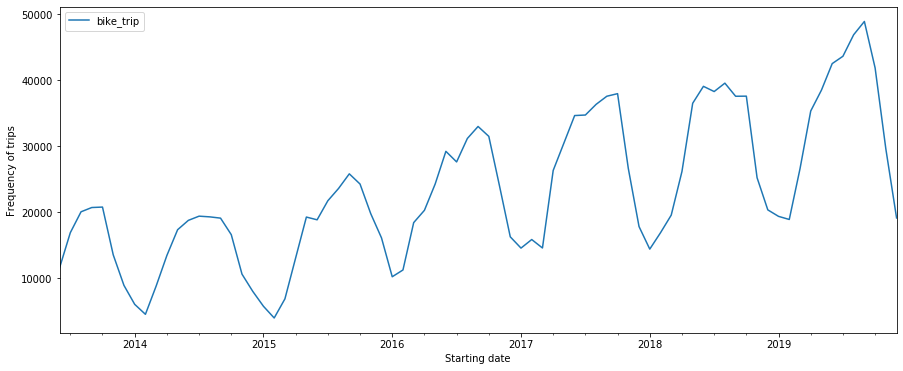

In [120]:
bike_group.plot()
plt.xlabel('Starting date')
plt.ylabel('Frequency of trips')

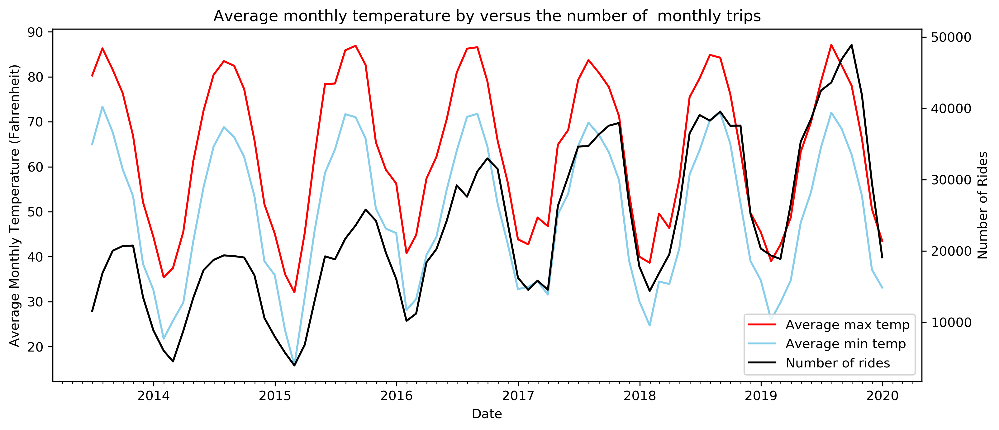

In [644]:
years = mdates.YearLocator()   # every year
months = mdates.MonthLocator()  # every month
years_fmt = mdates.DateFormatter('%Y')

## the plot
fig, ax= plt.subplots(figsize = (12, 5))

tmax = ax.plot('tmax', data = avg_temp, color = 'red')
tmin = ax.plot('tmin', data = avg_temp, color = 'skyblue')

## axis & legend labels
plt.xlabel('Date')
plt.ylabel('Average Monthly Temperature (Fahrenheit)')
#plt.legend(loc = 4, labels = ['Average max temp', 'Average min temp'])

ax.xaxis.set_major_locator(years)
ax.xaxis.set_major_formatter(years_fmt)
ax.xaxis.set_minor_locator(months)

ax2 = ax.twinx()
nrides = ax2.plot('bike_trip', data = bike_group, color = 'black')
ax2.set_ylabel('Number of Rides')
# ax2.legend(loc = 3, labels = ['Number of rides'])

lns = tmax+tmin+nrides
labs = ['Average max temp', 'Average min temp', 'Number of rides']
ax.legend(lns, labs, loc=4)
#ax.legend(lns, loc = 4, labels = ['Average max temp', 'Average min temp', 'Number of rides'])

plt.title('Average monthly temperature by versus the number of  monthly trips')
plt.show()

## Normalizing Trips

The weather data consisted of min and max temperatures by day. Thus, to normalize the frequency of trips I also aggregated them by day.

In [201]:
nday_uniqueid = season_norm.groupby(['startdate'])['bikeid'].nunique()

In [199]:
nday_trips = season_norm.groupby(['startdate'])['bike_trip'].sum()

In [205]:
nday_combined = pd.merge(nday_uniqueid, nday_trips, on = 'startdate')
nday_combined.head()

,bikeid,bike_trip
startdate,,
2013-06-01,154,161
2013-06-02,285,299
2013-06-03,123,128
2013-06-04,288,300
2013-06-05,306,319


In [298]:
daybikeid_min = min(nday_combined.bikeid)

daybikeid_max = max(nday_combined.bikeid)

daybikeid_mean = nday_combined.bikeid.mean()

daybikeid_sd = np.std(nday_combined.bikeid)

nrows = nday_combined.shape[0]

In [234]:
daytrips_min = min(nday_combined.bike_trip)

daytrips_max = max(nday_combined.bike_trip)

daytrips_mean = nday_combined.bike_trip.mean()

daytrips_sd = np.std(nday_combined.bike_trip)


In [302]:
np.mean(nday_combined.bike_trip)

767.1610346266166

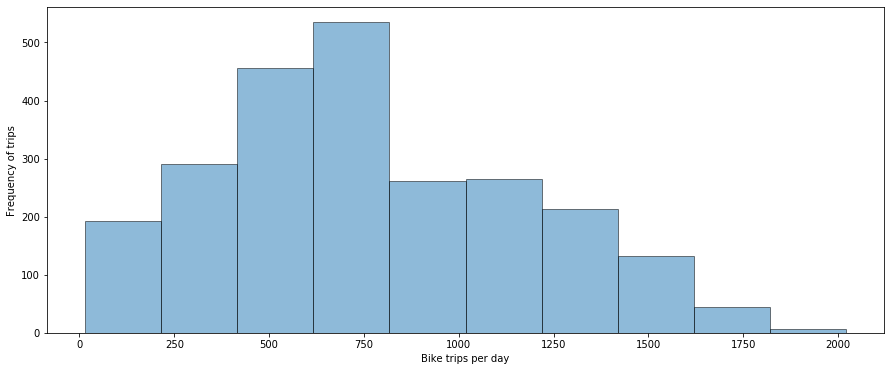

In [360]:
plt.hist(nday_combined.bike_trip, density = False, histtype='bar', edgecolor = 'k', alpha = 0.5)
plt.ylabel('Frequency of trips')
plt.xlabel('Bike trips per day')
plt.show()

In [361]:
triprow_norm = nday_combined.bike_trip.apply(lambda x: (x - daytrips_mean) / nrows)

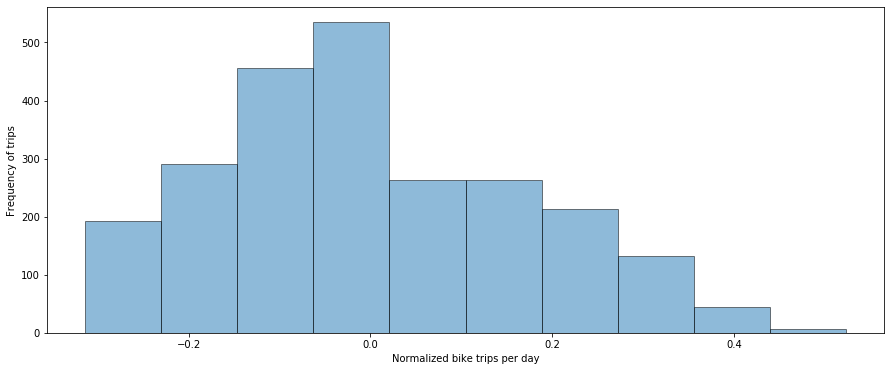

In [363]:
plt.hist(triprow_norm, density = False, histtype='bar', edgecolor = 'k', alpha = 0.5)
plt.ylabel('Frequency of trips')
plt.xlabel('Normalized bike trips per day')
plt.show()

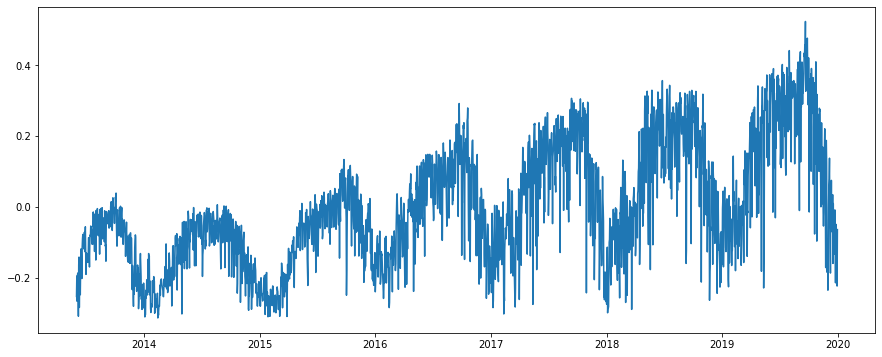

In [378]:
plt.plot(triprow_norm)

In [364]:
bikeid_norm = nday_combined.bike_trip.apply(lambda x: (x - daybikeid_mean) / nrows)

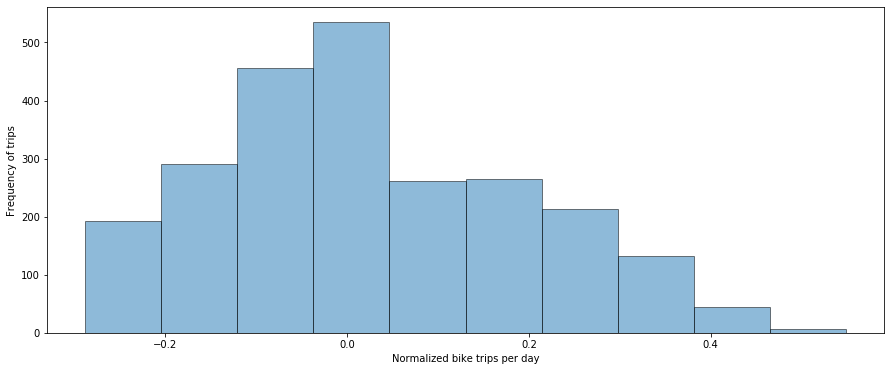

In [365]:
plt.hist(bikeid_norm , density = False, histtype='bar', edgecolor = 'k', alpha = 0.5)
plt.ylabel('Frequency of trips')
plt.xlabel('Normalized bike trips per day')
plt.show()

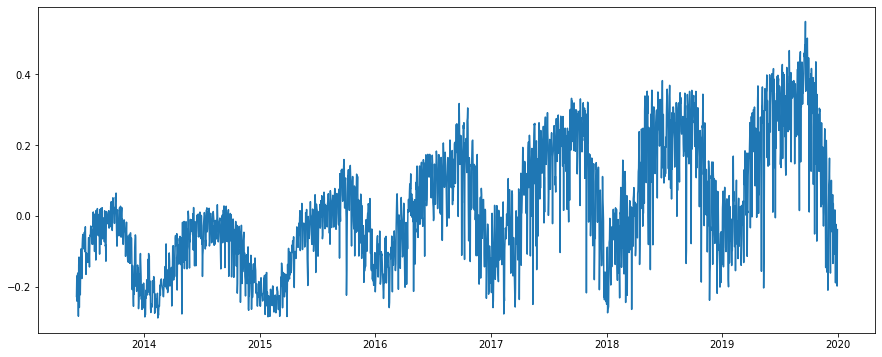

In [379]:
plt.plot(bikeid_norm)

**Standardized**

Below, the number of trips was standardized.

In [265]:
np.mean(nday_combined.bike_trip.apply(lambda x: (x - daytrips_mean) / daytrips_sd))

8.370442428463008e-16

In [300]:
sd_trips = nday_combined.bike_trip.apply(lambda x: (x - daytrips_mean) / daytrips_sd)

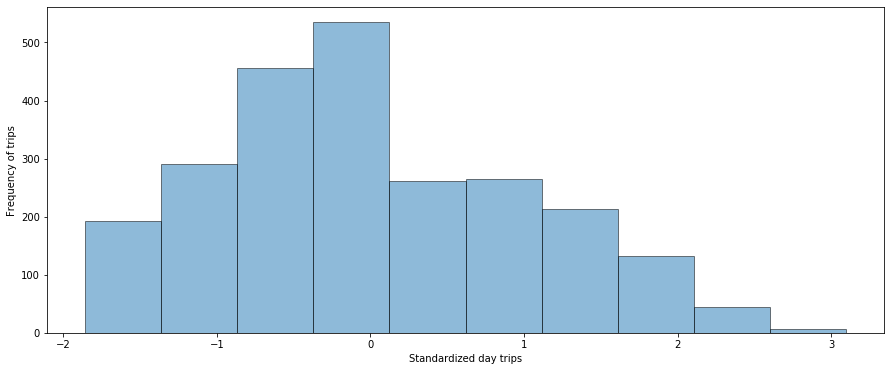

In [303]:
plt.hist(sd_trips, density = False, histtype='bar', edgecolor = 'k', alpha = 0.5)
plt.ylabel('Frequency of trips')
plt.xlabel('Standardized day trips')
plt.show()

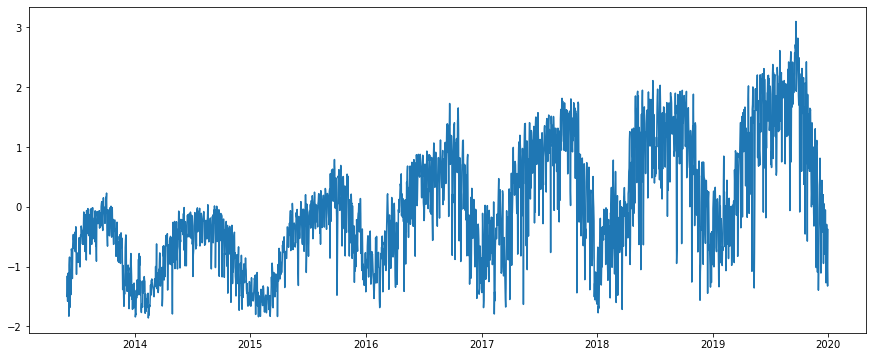

In [382]:
plt.plot(sd_trips)

Below, the number of trips was standardized by the number of unique bikes available in the sample on a given day. 

In [304]:
sd_tripsxbid = nday_combined.bike_trip.apply(lambda x: (x - daybikeid_mean) / daybikeid_sd)

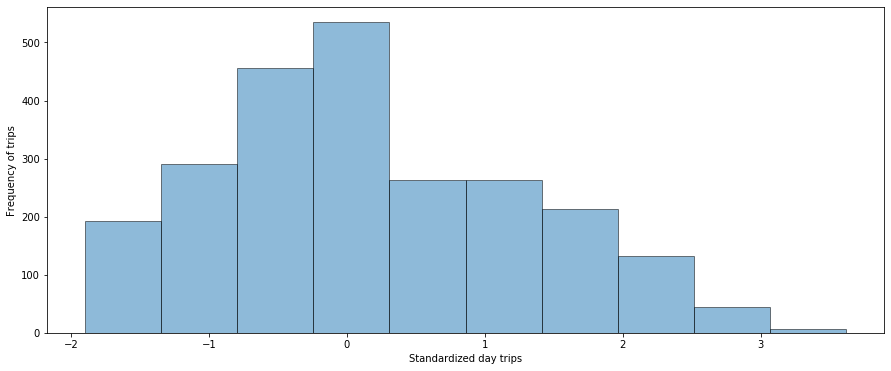

In [305]:
plt.hist(sd_tripsxbid, density = False, histtype='bar', edgecolor = 'k', alpha = 0.5)
plt.ylabel('Frequency of trips')
plt.xlabel('Standardized day trips')
plt.show()

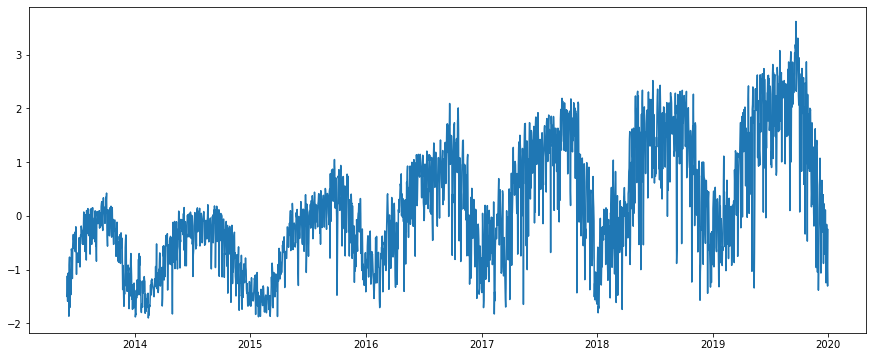

In [383]:
plt.plot(sd_tripsxbid)

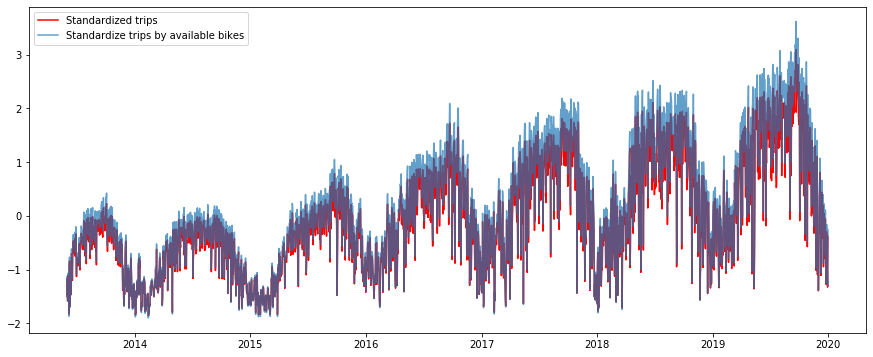

In [405]:
plt.plot(sd_trips, c='red', alpha = 1)
plt.plot(sd_tripsxbid, alpha = 0.7)
plt.legend(labels = ['Standardized trips', 'Standardize trips by available bikes'])

**Min-Max Normalization**

In [366]:
minmax_norm = nday_combined.bike_trip.apply(lambda x: (x - daytrips_min) / (daytrips_max - daytrips_min))

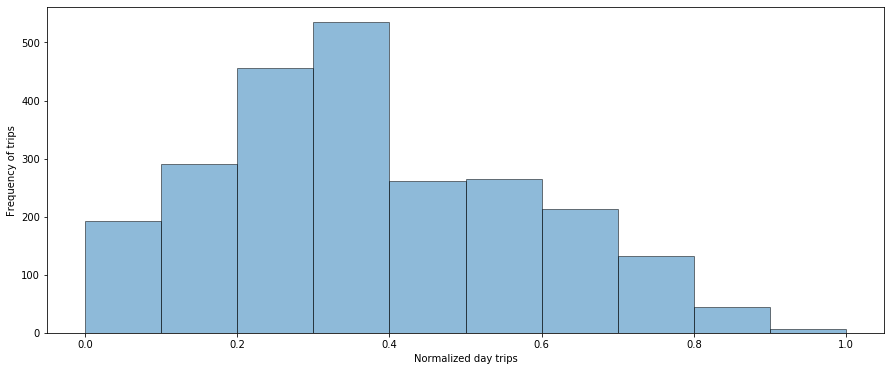

In [368]:
plt.hist(minmax_norm, density = False, histtype='bar', edgecolor = 'k', alpha = 0.5)
plt.ylabel('Frequency of trips')
plt.xlabel('Normalized day trips')
plt.show()

In [369]:
cpw.head()

,station,name,latitude,longitude,elevation,date,awnd,prcp,snow,snwd,tavg,tmax,tmin,tsun,wt01,wt02,wt03,wt04,wt06,wt08
0,USW00094728,"NY CITY CENTRAL PARK, NY US",40.77898,-73.96925,42.7,2013-06-01,3.80,0.00,0.0,0.0,NaN,90,73,NaN,NaN,NaN,NaN,NaN,NaN,NaN
1,USW00094728,"NY CITY CENTRAL PARK, NY US",40.77898,-73.96925,42.7,2013-06-02,6.04,0.85,0.0,0.0,NaN,88,69,NaN,1.0,NaN,NaN,NaN,NaN,NaN
2,USW00094728,"NY CITY CENTRAL PARK, NY US",40.77898,-73.96925,42.7,2013-06-03,3.36,0.87,0.0,0.0,NaN,78,66,NaN,1.0,NaN,NaN,NaN,NaN,NaN
3,USW00094728,"NY CITY CENTRAL PARK, NY US",40.77898,-73.96925,42.7,2013-06-04,4.92,0.00,0.0,0.0,NaN,75,57,NaN,NaN,NaN,NaN,NaN,NaN,NaN
4,USW00094728,"NY CITY CENTRAL PARK, NY US",40.77898,-73.96925,42.7,2013-06-05,3.80,0.00,0.0,0.0,NaN,74,58,NaN,NaN,NaN,NaN,NaN,NaN,NaN


In [397]:
#rcParams['figure.figsize'] = 10, 5

sdtrips_season = seasonal_decompose(sd_trips, model = 'additive', period = 365)


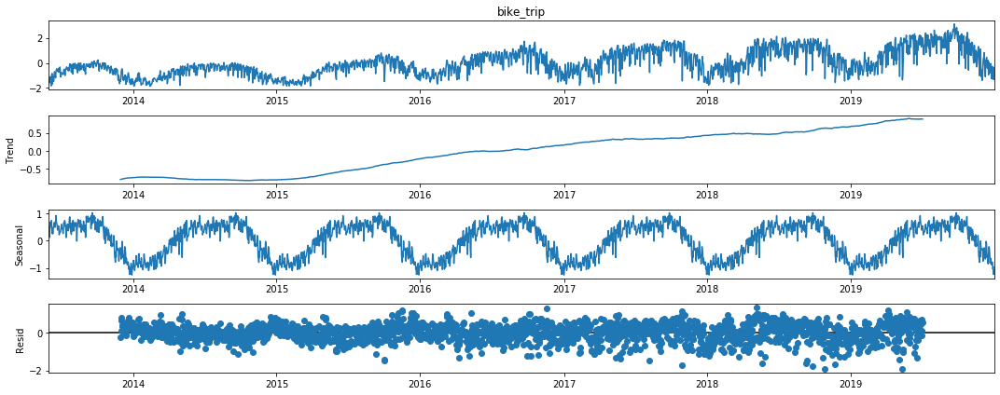

In [399]:
#rcParams['figure.figsize'] = 10, 5

sdtrips_season.plot()
plt.xticks()
plt.show()

Text(0.5, 1.0, 'Bike trip seasonality')

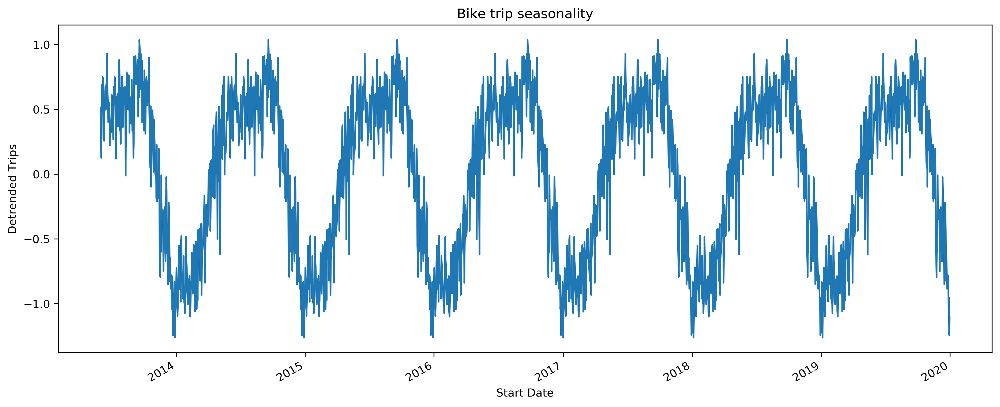

In [645]:
rcParams['figure.dpi'] = 300

sdtrips_season.seasonal.plot()
plt.ylabel('Detrended Trips')
plt.xlabel('Start Date')
plt.title('Standardized bike trip seasonality')

In [435]:
cpw_norm = cpw[['date', 'tmax', 'tmin']].copy()
cpw_norm.date = pd.to_datetime(cpw_norm.date)

In [436]:
tmax_mean = np.mean(cpw_norm.tmax)
tmax_sd = np.std(cpw_norm.tmax)

tmin_mean = np.mean(cpw_norm.tmin)
tmin_sd = np.std(cpw_norm.tmin)

In [437]:
cpw_norm['norm_max'] = cpw_norm.tmax.apply(lambda x: (x - tmax_mean) / tmax_sd)

cpw_norm['norm_min'] = cpw_norm.tmin.apply(lambda x: (x - tmin_mean) / tmin_sd)

cpw_norm.head()

,date,tmax,tmin,norm_max,norm_min
0,2013-06-01,90,73,1.420581,1.358541
1,2013-06-02,88,69,1.312250,1.126180
2,2013-06-03,78,66,0.770593,0.951909
3,2013-06-04,75,57,0.608097,0.429096
4,2013-06-05,74,58,0.553931,0.487186


**Standardized Temperatures for Scale Comparison:**

In [472]:
for x in np.arange(-3, 3, 1):
    for x2 in comp:
        

TypeError: zip argument #1 must support iteration

In [465]:
range(-3, 3, 1)

range(-3, 3)

In [469]:
comp = list(map(lambda x: (x * tmax_sd) + tmax_mean, np.arange(-3, 3, 1) ))

for _ in np.arange(-3, 3, 1):
    print(zip(_, comp))

TypeError: zip argument #1 must support iteration

In [461]:
list(map(lambda x: (x * tmax_sd) + tmax_mean, np.arange(-3, 3, 1) ))

for _ in list(map(lambda x: (x * tmax_sd) + tmax_mean, np.arange(-3, 3, 1) )):
    

[8.38771970997243,
 26.849609397777876,
 45.31149908558332,
 63.773388773388774,
 82.23527846119423,
 100.69716814899968]

In [462]:
list(map(lambda x: (x * tmin_sd) + tmin_mean, np.arange(-3, 3, 1) ))

[-2.0303775190726228,
 15.184183525053456,
 32.398744569179534,
 49.61330561330561,
 66.82786665743168,
 84.04242770155777]

In [452]:
# tdf = pd.DataFrame(sd_trips)
# tdf.index = pd.to_datetime(tdf.index)
# tdf.head()

sd_trips_df = pd.DataFrame(sd_trips).reset_index()
sd_trips_df.startdate = pd.to_datetime(sd_trips_df.startdate)
sd_trips_df.head()

,startdate,bike_trip
0,2013-06-01,-1.497262
1,2013-06-02,-1.156392
2,2013-06-03,-1.578774
3,2013-06-04,-1.153922
4,2013-06-05,-1.106990


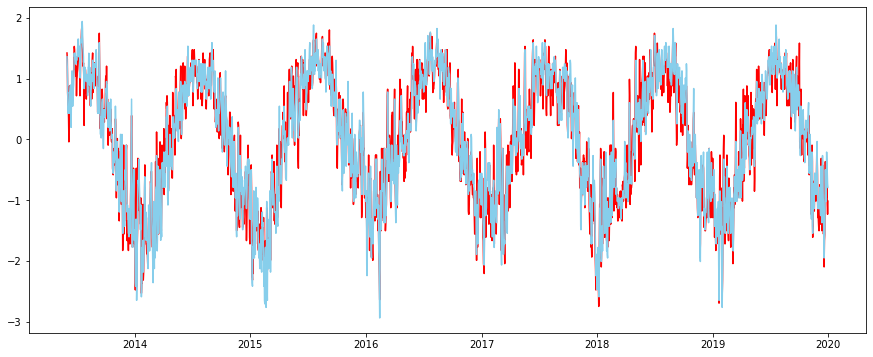

In [438]:
plt.plot('date', 'norm_max', data = cpw_norm, color = 'red')
plt.plot('date', 'norm_min', data = cpw_norm, color = 'skyblue')

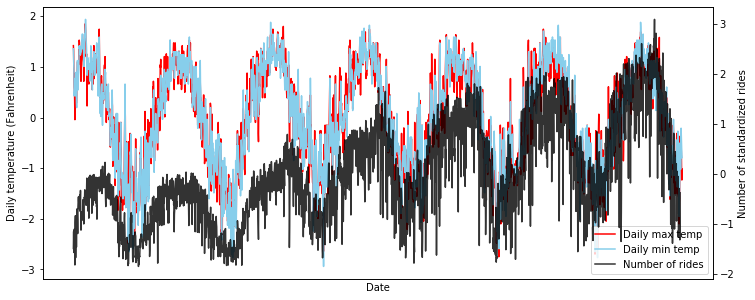

In [453]:
years = mdates.YearLocator()   # every year
months = mdates.MonthLocator()  # every month
days = mdates.DayLocator()
years_fmt = mdates.DateFormatter('%Y')

## the plot
fig, ax= plt.subplots(figsize = (12, 5))

tmax = ax.plot('norm_max', data = cpw_norm, color = 'red')
tmin = ax.plot('norm_min', data = cpw_norm, color = 'skyblue')

## axis & legend labels
plt.xlabel('Date')
plt.ylabel('Daily temperature (Fahrenheit)')
#plt.legend(loc = 4, labels = ['Average max temp', 'Average min temp'])

ax.xaxis.set_major_locator(years)
ax.xaxis.set_major_formatter(years_fmt)
ax.xaxis.set_minor_locator(days)

ax2 = ax.twinx()
nrides = ax2.plot('bike_trip', data = sd_trips_df, color = 'black', alpha = 0.8)
ax2.set_ylabel('Number of standardized rides')
# ax2.legend(loc = 3, labels = ['Number of rides'])

lns = tmax+tmin+nrides
labs = ['Daily max temp', 'Daily min temp', 'Number of rides']
ax.legend(lns, labs, loc=4)
#ax.legend(lns, loc = 4, labels = ['Average max temp', 'Average min temp', 'Number of rides'])

plt.show()

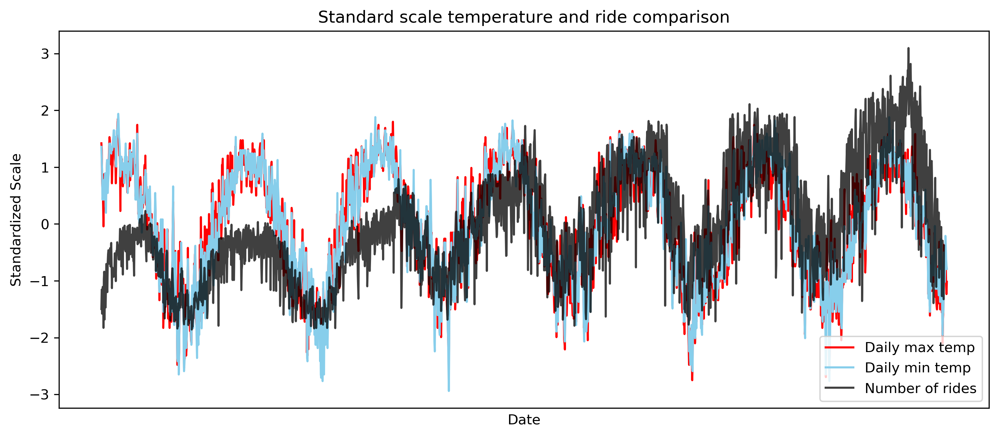

In [646]:
rcParams['figure.dpi'] = 300

years = mdates.YearLocator()   # every year
months = mdates.MonthLocator() # every month
days = mdates.DayLocator()     # every day
years_fmt = mdates.DateFormatter('%Y')

## the plot
fig, ax= plt.subplots(figsize = (12, 5))

tmax = ax.plot('norm_max', data = cpw_norm, color = 'red')
tmin = ax.plot('norm_min', data = cpw_norm, color = 'skyblue')

## axis & legend labels
plt.xlabel('Date')
plt.ylabel('Standardized Scale')


ax.xaxis.set_major_locator(years)
ax.xaxis.set_major_formatter(years_fmt)
ax.xaxis.set_minor_locator(months)


nrides = ax.plot('bike_trip', data = sd_trips_df, color = 'black', alpha = 0.75)
ax2.set_ylabel('Number of standardized rides')


lns = tmax+tmin+nrides
labs = ['Daily max temp', 'Daily min temp', 'Number of rides']
ax.legend(lns, labs, loc=4)
#ax.legend(lns, loc = 4, labels = ['Average max temp', 'Average min temp', 'Number of rides'])

plt.title('Standard scale temperature and ride comparison')
plt.show()

## Bike Trip Map

In [59]:
sampled_trips = sampled2.copy()
sampled_trips['bike_trip'] = 1

In [60]:
##using head(100)
##startstation_freq = sampled_trips[['startstationname','bike_trip']].groupby('startstationname').count().sort_values(by = 'bike_trip', ascending = False).head(100)

## all records
startstation_freq = sampled_trips[['startstationname','bike_trip']].groupby('startstationname').count().sort_values(by = 'bike_trip', ascending = False)
startstation_freq.reset_index(inplace = True)
startstation_freq

,startstationname,bike_trip
0,Pershing Square North,15029
1,E 17 St & Broadway,13170
2,W 21 St & 6 Ave,12341
3,8 Ave & W 31 St,12118
4,Broadway & E 22 St,11956
...,...,...
1059,Onderdonk Ave & Gates Ave,1
1060,Prospect Park - 5 Year Anniversary Celebration,1
1061,Cypress Ave & Palmetto St,1
1062,Cypress Ave & George St,1


In [61]:
lat_long = sampled_trips[['startstationname','startstationlatitude','startstationlongitude']]


In [62]:
startgis_df = pd.merge(startstation_freq, lat_long, how = 'left', on = 'startstationname')
startgis_df = startgis_df.groupby('startstationname').first().reset_index()
startgis_df.sort_values(by = 'bike_trip', ascending = False)

,startstationname,bike_trip,startstationlatitude,startstationlongitude
793,Pershing Square North,15029,40.751873,-73.977706
403,E 17 St & Broadway,13170,40.737050,-73.990093
950,W 21 St & 6 Ave,12341,40.741740,-73.994156
144,8 Ave & W 31 St,12118,40.750585,-73.994685
216,Broadway & E 22 St,11956,40.740343,-73.989551
...,...,...,...,...
773,Onderdonk Ave & Gates Ave,1,40.704130,-73.907370
809,Prospect Park - 5 Year Anniversary Celebration,1,40.660652,-73.964590
341,Cypress Ave & Palmetto St,1,40.701573,-73.908763
340,Cypress Ave & George St,1,40.698120,-73.902710


In [63]:
# colors = [
#     'red',
#     'blue',
#     'gray',
#     'darkred',
#     'lightred',
#     'orange',
#     'beige',
#     'green',
#     'darkgreen',
#     'lightgreen',
#     'darkblue',
#     'lightblue',
#     'purple',
#     'darkpurple',
#     'pink',
#     'cadetblue',
#     'lightgray',
#     'black'
# ]

In [64]:
def colors(trips):
    if trips > 10000:
        return 'darkpurple'
    elif trips > 5000:
        return 'darkblue'
    elif trips > 1000:
        return 'darkgreen'
    else:
        return 'darkred'

In [65]:
startgis_df.head()

,startstationname,bike_trip,startstationlatitude,startstationlongitude
0,1 Ave & E 110 St,524,40.792327,-73.938300
1,1 Ave & E 15 St,3121,40.732219,-73.981656
2,1 Ave & E 16 St,4963,40.732219,-73.981656
3,1 Ave & E 18 St,5355,40.733812,-73.980544
4,1 Ave & E 30 St,5238,40.741444,-73.975361


In [68]:
boroughs_path = "../citibike_data/Borough_Boundaries/Borough_Boundaries.geojson"


**Initial Cluster Marker Map**

In [70]:
import folium
from folium.plugins import FastMarkerCluster, MarkerCluster  

## tiles = CartoDB dark_matter; 'OpenStreetMap'
manhattan = folium.Map(location = [40.758896, -73.985130], zoom_start = 12, tiles = "cartodbpositron")

mc = MarkerCluster(name = "Marker Cluster")

for index, row in startgis_df.iterrows():
    popup_text = "Station: {}, Trips: {}".format(
                      row["startstationname"],
                      row["bike_trip"])
    folium.CircleMarker(location=[row["startstationlatitude"],row["startstationlongitude"]],
                        radius= 5,
                        color="green",
                        popup=popup_text,
                        fill=True).add_to(mc)
    
folium.GeoJson(
    boroughs_path,
    name='boroughs'
).add_to(manhattan)    

mc.add_to(manhattan)

folium.LayerControl().add_to(manhattan)

manhattan

**Marker Cluster 2**

In [71]:
# startstationname	bike_trip	startstationlatitude	startstationlongitude

In [72]:
startname = list(startgis_df.startstationname)
start_trips = list(startgis_df.bike_trip)
start_lat = list(startgis_df.startstationlatitude)
start_lon = list(startgis_df.startstationlongitude)

In [73]:
popup_text = "Station: {}, Trips: {}".format(
                      startgis_df["startstationname"],
                      startgis_df["bike_trip"])
    
#     str(name)+": "+ str(trip)

In [74]:
## tiles = CartoDB dark_matter; 'OpenStreetMap'

manhattan = folium.Map(location = [40.758896, -73.985130], zoom_start = 12, tiles = "OpenStreetMap")

mc = MarkerCluster(name = "Marker Cluster")

for index, row in startgis_df.iterrows():
    popup_text = "Station: {}, Trips: {}".format(
                      row["startstationname"],
                      row["bike_trip"])
    
    folium.CircleMarker(location=[row['startstationlatitude'], row['startstationlongitude']], 
                                     radius = 6, 
                                     popup=popup_text,
                                     fill_color=colors(row['bike_trip']), 
                                     color = 'grey', 
                                     fill_opacity=0.6).add_to(mc)
    
folium.GeoJson(
    boroughs_path,
    name='boroughs'
).add_to(manhattan)    

mc.add_to(manhattan)

folium.LayerControl().add_to(manhattan)

manhattan

In [75]:
## tiles = CartoDB dark_matter; 'OpenStreetMap'

manhattan = folium.Map(location = [40.758896, -73.985130], zoom_start = 12, tiles = "cartodbpositron")

fg = folium.FeatureGroup(name="My Map")

for index, row in startgis_df.iterrows():
    popup_text = "Station: {}, Trips: {}".format(
                      row["startstationname"],
                      row["bike_trip"])
    
    
    folium.CircleMarker(location=[row['startstationlatitude'], row['startstationlongitude']], 
                                     radius = 6, 
                                     popup=popup_text,
                                     fill_color=colors(row['bike_trip']), 
                                     color = 'grey', 
                                     fill_opacity=0.6).add_to(fg)
    
folium.GeoJson(
    boroughs_path,
    name='boroughs'
).add_to(manhattan)

manhattan.add_child(fg)

folium.LayerControl().add_to(manhattan)

manhattan

In [76]:
from folium.plugins import HeatMap

## tiles = CartoDB dark_matter #OpenStreetMap
manhattan = folium.Map(location = [40.758896, -73.985130], zoom_start = 12, tiles = "OpenStreetMap")


heat_data = [[row['startstationlatitude'], row['startstationlongitude']] for index, row in startgis_df.iterrows()]

folium.GeoJson(
    boroughs_path,
    name='boroughs'
).add_to(manhattan)

HeatMap(heat_data, min_opacity = 0.5).add_to(manhattan)

manhattan

## Notes:

**Rolling averages** are a way to smooth data
- You average over time;
    - smooths by average
    - 1D conv. NN
- Essentially, you take the average of 4 elements and roll over 1 place and average those 4 elements (minus the first 1 etc.)

**Number of Unique Bikes** can be used as a proxy for normalization

In [77]:
# season_test.groupby(pd.Grouper(freq = 'M'))['bikeid'].nunique()

In [78]:
bike_test.groupby(bike_test.index)['bikeid'].value_counts()

startdate   bikeid
2013-06-01  15015     2
            15647     2
            17910     2
            19402     2
            19411     2
                     ..
2019-12-31  41997     1
            42021     1
            42028     1
            42038     1
            42040     1
Name: bikeid, Length: 1690686, dtype: int64

In [79]:
bike_test.groupby(bike_test.index)['bikeid'].nunique()

startdate
2013-06-01    154
2013-06-02    285
2013-06-03    123
2013-06-04    288
2013-06-05    306
             ... 
2019-12-27    616
2019-12-28    539
2019-12-29    338
2019-12-30    227
2019-12-31    589
Name: bikeid, Length: 2397, dtype: int64

## Number of starting bike trips per hour

In [80]:
sampled2.startdate = pd.to_datetime(sampled2.startdate)

sampled2.stopdate = pd.to_datetime(sampled2.stopdate)

In [81]:
sampled2['bike_trip'] = 1

In [82]:
sampled2['start_hour'] = pd.to_datetime(sampled2.starttime2).dt.hour

sampled2['stop_hour'] = pd.to_datetime(sampled2.stoptime2).dt.hour

In [83]:
start_df = pd.DataFrame(sampled2[['start_hour', 'bike_trip']].groupby('start_hour')['bike_trip'].sum()).reset_index()

stop_df = pd.DataFrame(sampled2[['stop_hour', 'bike_trip']].groupby('stop_hour')['bike_trip'].sum()).reset_index()

Text(0.5, 1.0, 'Frequency of trips by starting hour')

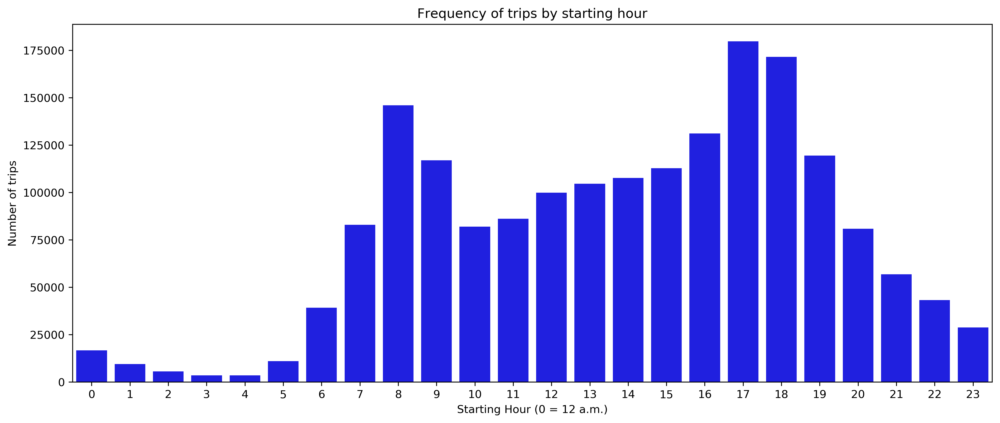

In [607]:
rcParams['figure.dpi'] = 300
sns.barplot(x = 'start_hour', y = 'bike_trip', data = start_df, color = 'blue')
plt.xlabel('Starting Hour (0 = 12 a.m.)')
plt.ylabel('Number of trips')
plt.title('Frequency of trips by starting hour')

Text(0.5, 1.0, 'Frequency of trips by stopping hour')

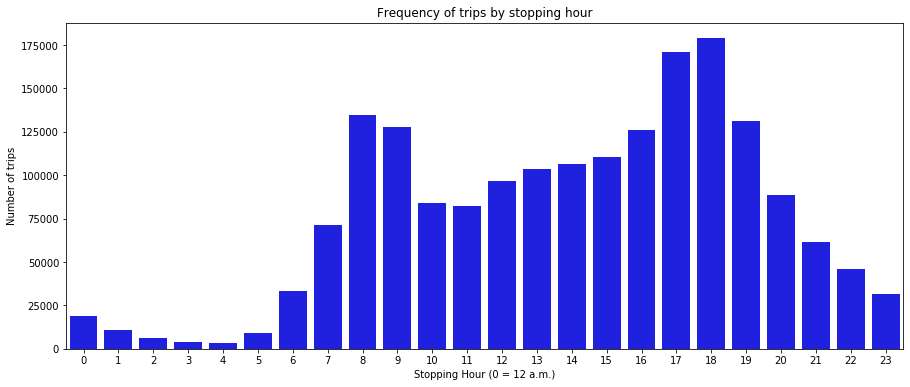

In [85]:
sns.barplot(x = 'stop_hour', y = 'bike_trip', data = stop_df, color = 'blue')
plt.xlabel('Stopping Hour (0 = 12 a.m.)')
plt.ylabel('Number of trips')
plt.title('Frequency of trips by stopping hour')

In [512]:
start_gender = pd.DataFrame(sampled2[['start_hour', 'bike_trip', 'gender', 'usertype']].groupby(['start_hour', 'gender'])['bike_trip'].sum()).reset_index()

stop_gender = pd.DataFrame(sampled2[['stop_hour', 'bike_trip', 'gender', 'usertype']] .groupby(['stop_hour', 'gender'])['bike_trip'].sum()).reset_index()


In [513]:
start_gender['proportion'] = start_gender.bike_trip / sum(start_gender.bike_trip)

stop_gender['proportion'] = stop_gender.bike_trip / sum(stop_gender.bike_trip)

In [535]:
gender_prop = pd.DataFrame(start_gender.groupby('gender')['bike_trip'].sum())
gender_prop.reset_index(inplace = True)
gender_prop['proportion'] = gender_prop.bike_trip.apply(lambda x: x / sampled2.shape[0])
gender_prop

,gender,bike_trip
0,Female,410439
1,Male,1240767
2,Unknown,187679


Text(0.5, 1.0, 'Proportion of trips by genger')

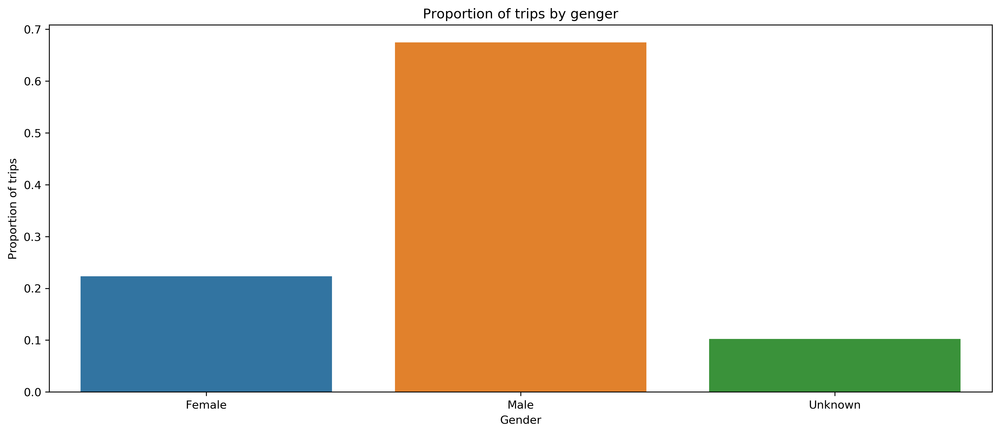

In [554]:
rcParams['figure.dpi'] = 300
sns.barplot(x = 'gender', y = 'proportion', data = gender_prop, ci = None )
plt.xlabel('Gender')
plt.ylabel('Proportion of trips')
plt.title('Proportion of trips by genger')


Text(0.5, 1.0, 'Proportion of trips by starting hour and genger')

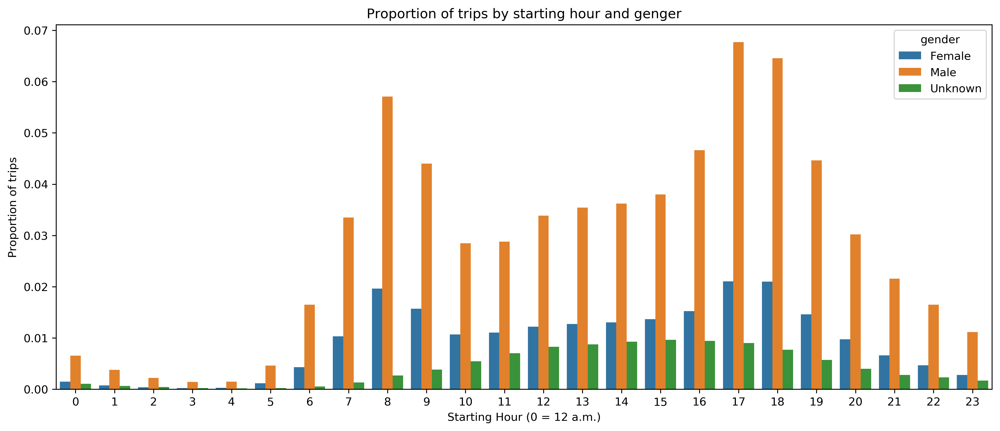

In [600]:
rcParams['figure.dpi'] = 300
sns.barplot(x = 'start_hour', y = 'proportion', hue = 'gender', data = start_gender)
plt.xlabel('Starting Hour (0 = 12 a.m.)')
plt.ylabel('Proportion of trips')
plt.title('Proportion of trips by starting hour and genger')


Text(0.5, 1.0, 'Proportion of trips by stopping hour and genger')

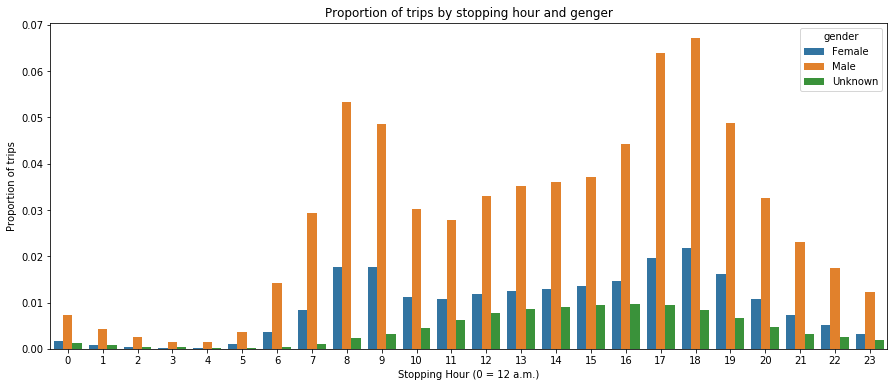

In [516]:
sns.barplot(x = 'stop_hour', y = 'proportion', hue = 'gender', data = stop_gender)
plt.xlabel('Stopping Hour (0 = 12 a.m.)')
plt.ylabel('Proportion of trips')
plt.title('Proportion of trips by stopping hour and genger')

In [90]:
start_type = pd.DataFrame(sampled2[['start_hour', 'bike_trip', 'usertype']].groupby(['start_hour', 'usertype'])['bike_trip'].sum()).reset_index()

stop_type = pd.DataFrame(sampled2[['stop_hour', 'bike_trip', 'usertype']].groupby(['stop_hour', 'usertype'])['bike_trip'].sum()).reset_index()

In [91]:
start_type['proportion'] = start_type.bike_trip / sum(start_type.bike_trip)

stop_type['proportion'] = stop_type.bike_trip / sum(stop_type.bike_trip)

In [603]:
user_prop = pd.DataFrame(start_type.groupby('usertype')['bike_trip'].sum())
user_prop.reset_index(inplace = True)
user_prop['proportion'] = user_prop.bike_trip.apply(lambda x: x / sampled2.shape[0])
user_prop

,usertype,bike_trip,proportion
0,Customer,221628,0.120523
1,Subscriber,1616298,0.878955


Text(0.5, 1.0, 'Proportion of trips by Usertype')

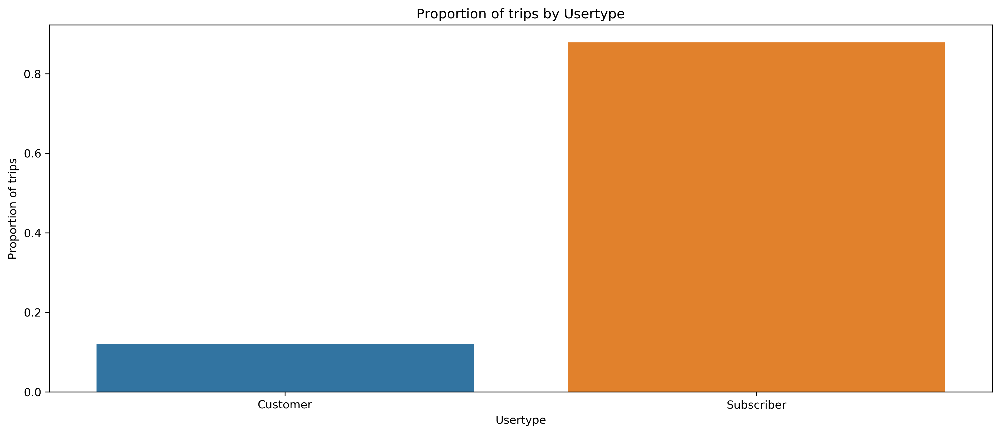

In [604]:
rcParams['figure.dpi'] = 300

sns.barplot(x = 'usertype', y = 'proportion', data = user_prop, ci = None )
plt.xlabel('Usertype')
plt.ylabel('Proportion of trips')
plt.title('Proportion of trips by Usertype')


Text(0.5, 1.0, 'Proportion of trips by starting hour and usertype')

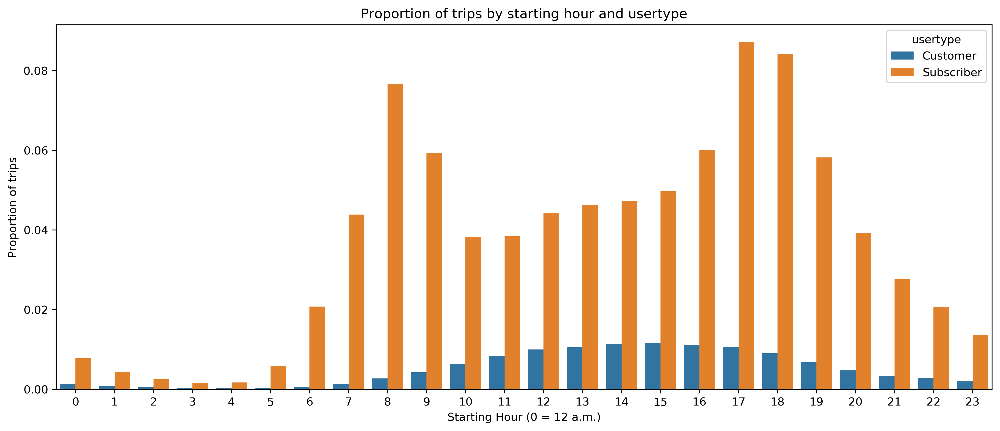

In [630]:
rcParams['figure.dpi'] = 300

sns.barplot(x = 'start_hour', y = 'proportion', hue = 'usertype', data = start_type)
plt.xlabel('Starting Hour (0 = 12 a.m.)')
plt.ylabel('Proportion of trips')
plt.title('Proportion of trips by starting hour and usertype')

Text(0.5, 1.0, 'Proportion of trips by stopping hour and usertype')

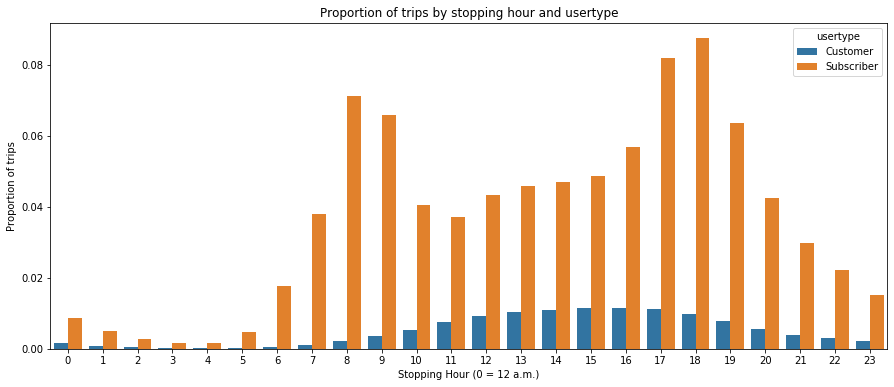

In [93]:
sns.barplot(x = 'stop_hour', y = 'proportion', hue = 'usertype', data = stop_type)
plt.xlabel('Stopping Hour (0 = 12 a.m.)')
plt.ylabel('Proportion of trips')
plt.title('Proportion of trips by stopping hour and usertype')

## Day of the Week

In [94]:
sampled2.head()

,tripduration,starttime,stoptime,startstationid,startstationname,startstationlatitude,startstationlongitude,endstationid,endstationname,endstationlatitude,...,usertype,birthyear,gender,startdate,starttime2,stopdate,stoptime2,bike_trip,start_hour,stop_hour
0,671,2017-09-25 13:59:44,2017-09-25 14:10:56,341.0,Stanton St & Mangin St,40.717821,-73.976289,82.0,St James Pl & Pearl St,40.711174,...,Subscriber,1980,2,2017-09-25,13:59:44,2017-09-25,14:10:56,1,13,14
1,763,2017-09-11 08:14:44,2017-09-11 08:27:27,403.0,E 2 St & 2 Ave,40.725029,-73.990697,2010.0,Grand St & Greene St,40.721655,...,Subscriber,1966,2,2017-09-11,08:14:44,2017-09-11,08:27:27,1,8,8
2,908,2017-09-01 12:37:12,2017-09-01 12:52:21,359.0,E 47 St & Park Ave,40.755103,-73.974987,428.0,E 3 St & 1 Ave,40.724677,...,Subscriber,1986,1,2017-09-01,12:37:12,2017-09-01,12:52:21,1,12,12
3,370,2017-09-05 19:35:46,2017-09-05 19:41:56,3076.0,Scholes St & Manhattan Ave,40.708704,-73.944862,3068.0,Humboldt St & Varet St,40.703172,...,Customer,NaN,0,2017-09-05,19:35:46,2017-09-05,19:41:56,1,19,19
4,871,2017-09-26 09:10:07,2017-09-26 09:24:39,487.0,E 20 St & FDR Drive,40.733143,-73.975739,486.0,Broadway & W 29 St,40.746201,...,Subscriber,1984,2,2017-09-26,09:10:07,2017-09-26,09:24:39,1,9,9


In [95]:
# sampled2.startdate = pd.to_datetime(sampled2.startdate)

# sampled2.stopdate = pd.to_datetime(sampled2.stopdate)

In [96]:
# sampled2['bike_trip'] = 1

In [97]:
sampled2['start_day'] = sampled2.startdate.dt.dayofweek

In [98]:
day_df = pd.DataFrame(sampled2.groupby('start_day')['bike_trip'].sum()).reset_index()

In [99]:
day_df.head()

,start_day,bike_trip
0,0,263344
1,1,279765
2,2,290440
3,3,282345
4,4,274211


([<matplotlib.axis.XTick at 0x1b9de47a50>,
 <a list of 7 Text xticklabel objects>)

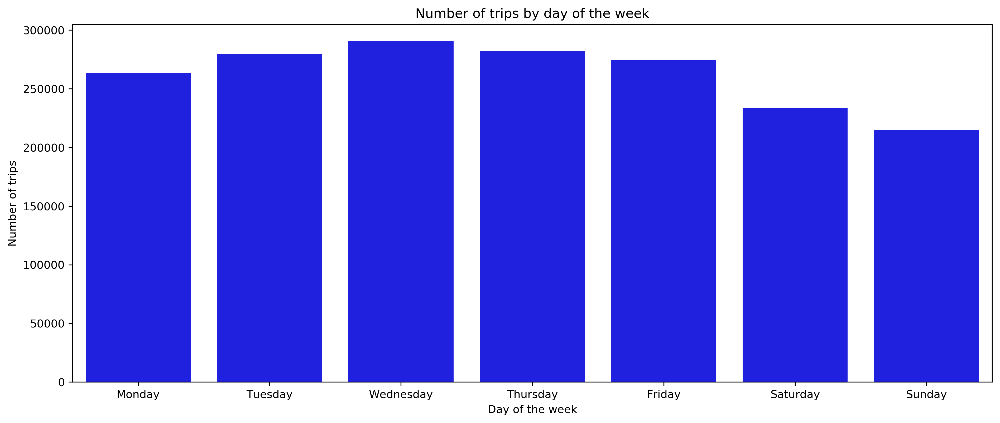

In [631]:
rcParams['figure.dpi'] = 300

sns.barplot(x = 'start_day', y = 'bike_trip', data = day_df, color = 'blue')

plt.xlabel('Day of the week')
plt.ylabel('Number of trips')
plt.title('Number of trips by day of the week')

plt.xticks(ticks = np.arange(7), labels = ['Monday', 'Tuesday', 'Wednesday', 'Thursday', 'Friday', 'Saturday', 'Sunday'])


In [102]:
day_df['weekend'] = np.where(day_df['start_day'] >=5, 'weekend', 'weekday')

In [103]:
day_df.groupby('weekend')['bike_trip'].sum()

weekend
weekday    1390105
weekend     448780
Name: bike_trip, dtype: int64

In [104]:
start_day_hour = sampled2[['start_day', 'start_hour', 'bike_trip']]

In [105]:
start_day_hour['weekend'] = np.where(start_day_hour['start_day'] >=5, 'weekend', 'weekday')

/Users/Tyler/anaconda3/lib/python3.7/site-packages/ipykernel_launcher.py:1: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  """Entry point for launching an IPython kernel.


In [106]:
sdh_plot = start_day_hour.groupby(['start_hour','weekend'])['bike_trip'].sum()


In [107]:
sdh_plot = pd.DataFrame(sdh_plot)

In [108]:
sdh_plot['proportion'] = sdh_plot.bike_trip / sum(sdh_plot.bike_trip)

sdh_plot.reset_index(inplace = True)

In [109]:
sdh_plot.groupby('weekend')['proportion'].sum()

weekend
weekday    0.75595
weekend    0.24405
Name: proportion, dtype: float64

Text(0, 0.5, 'Number of trips')

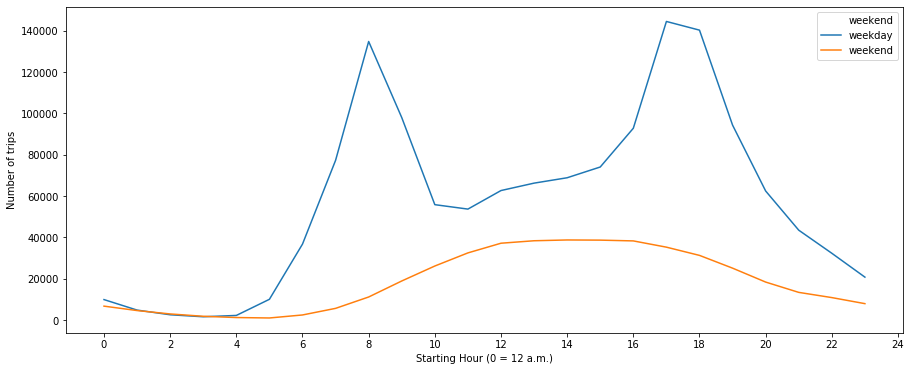

In [110]:
sns.lineplot(x = 'start_hour', y = 'bike_trip', hue = 'weekend', data = sdh_plot)
plt.xticks(np.arange(0,25,2))
plt.xlabel('Starting Hour (0 = 12 a.m.)')
plt.ylabel('Number of trips')

Text(0, 0.5, 'Proportion of trips')

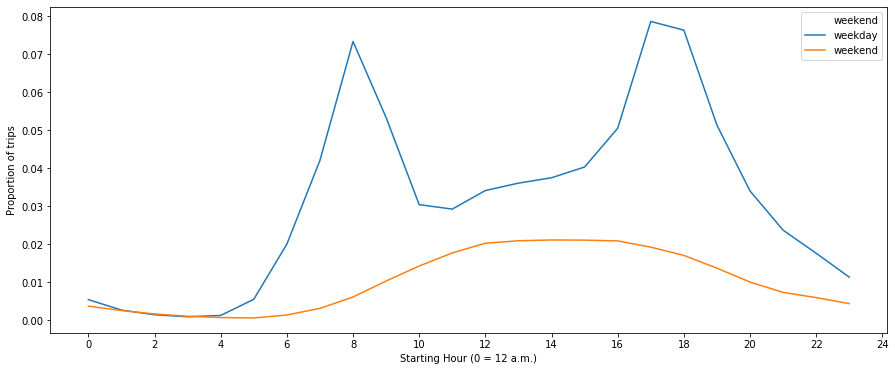

In [111]:
sns.lineplot(x = 'start_hour', y = 'proportion', hue = 'weekend', data = sdh_plot)
plt.xticks(np.arange(0,25,2))
plt.xlabel('Starting Hour (0 = 12 a.m.)')
plt.ylabel('Proportion of trips')

Text(0.5, 1.0, 'Proportion of trips by starting hour and weekday or weekend')

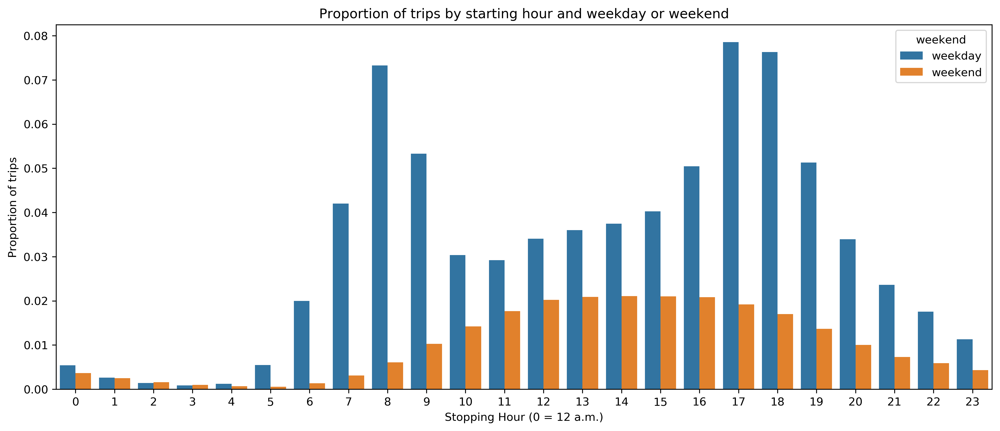

In [632]:
rcParams['figure.dpi'] = 300

sns.barplot(x = 'start_hour', y = 'proportion', hue = 'weekend', data = sdh_plot)
plt.xlabel('Stopping Hour (0 = 12 a.m.)')
plt.ylabel('Proportion of trips')
plt.title('Proportion of trips by starting hour and weekday or weekend')

**Winter**

I created a binary column to signify whether or not it was winter to examine the impact on trip starting time. `0` represents not winter and `1` represents winter. This is based on the calander period for official winter: December 21. Spring begins on March 20.

In [623]:
winter = sampled2.copy()
winter.startdate = pd.to_datetime(winter.startdate)

In [ ]:
w_months = [12, 1, 2 , 3]
w_day []

In [ ]:
winter.startdate.apply(lambda x: 1 if (x.month == 12) & (x.day == 21) else 0 )

In [624]:
winter['winter'] = winter.startdate.apply(lambda x: 1 if (x.month == 12) & (x.day == 21) else 0 )


In [625]:
winter.head()

,tripduration,starttime,stoptime,startstationid,startstationname,startstationlatitude,startstationlongitude,endstationid,endstationname,endstationlatitude,...,gender,startdate,starttime2,stopdate,stoptime2,bike_trip,start_hour,stop_hour,start_day,winter
0,671,2017-09-25 13:59:44,2017-09-25 14:10:56,341.0,Stanton St & Mangin St,40.717821,-73.976289,82.0,St James Pl & Pearl St,40.711174,...,Female,2017-09-25,13:59:44,2017-09-25,14:10:56,1,13,14,0,0
1,763,2017-09-11 08:14:44,2017-09-11 08:27:27,403.0,E 2 St & 2 Ave,40.725029,-73.990697,2010.0,Grand St & Greene St,40.721655,...,Female,2017-09-11,08:14:44,2017-09-11,08:27:27,1,8,8,0,0
2,908,2017-09-01 12:37:12,2017-09-01 12:52:21,359.0,E 47 St & Park Ave,40.755103,-73.974987,428.0,E 3 St & 1 Ave,40.724677,...,Male,2017-09-01,12:37:12,2017-09-01,12:52:21,1,12,12,4,0
3,370,2017-09-05 19:35:46,2017-09-05 19:41:56,3076.0,Scholes St & Manhattan Ave,40.708704,-73.944862,3068.0,Humboldt St & Varet St,40.703172,...,Unknown,2017-09-05,19:35:46,2017-09-05,19:41:56,1,19,19,1,0
4,871,2017-09-26 09:10:07,2017-09-26 09:24:39,487.0,E 20 St & FDR Drive,40.733143,-73.975739,486.0,Broadway & W 29 St,40.746201,...,Female,2017-09-26,09:10:07,2017-09-26,09:24:39,1,9,9,1,0


Below, I created a proportion column to easily compare across groups. 

In [626]:
winter_df = winter[['winter', 'start_hour', 'bike_trip']].copy()
winter_df = winter_df.groupby(['winter', 'start_hour'])['bike_trip'].sum()
winter_df = pd.DataFrame(winter_df)
winter_df['proportion'] = winter_df.bike_trip / sum(winter_df.bike_trip)
winter_df.reset_index(inplace = True)
winter_df

,winter,start_hour,bike_trip,proportion
0,0,0,16621,0.009039
1,0,1,9411,0.005118
2,0,2,5519,0.003001
3,0,3,3420,0.001860
4,0,4,3455,0.001879
5,0,5,11038,0.006003
6,0,6,39155,0.021293
7,0,7,82793,0.045023
8,0,8,145688,0.079226
9,0,9,116648,0.063434


We can see that ther

In [627]:
winter_df.groupby('winter')['proportion'].sum()

winter
0    0.9981
1    0.0019
Name: proportion, dtype: float64

In [628]:
sdh_plot = start_day_hour.groupby(['start_hour','weekend'])['bike_trip'].sum()


sdh_plot = pd.DataFrame(sdh_plot)

sdh_plot['proportion'] = sdh_plot.bike_trip / sum(sdh_plot.bike_trip)

sdh_plot.reset_index(inplace = True)

sdh_plot.groupby('weekend')['proportion'].sum()

weekend
weekday    0.75595
weekend    0.24405
Name: proportion, dtype: float64

Text(0.5, 1.0, 'Proportion of trips by starting hour and weekday or weekend')

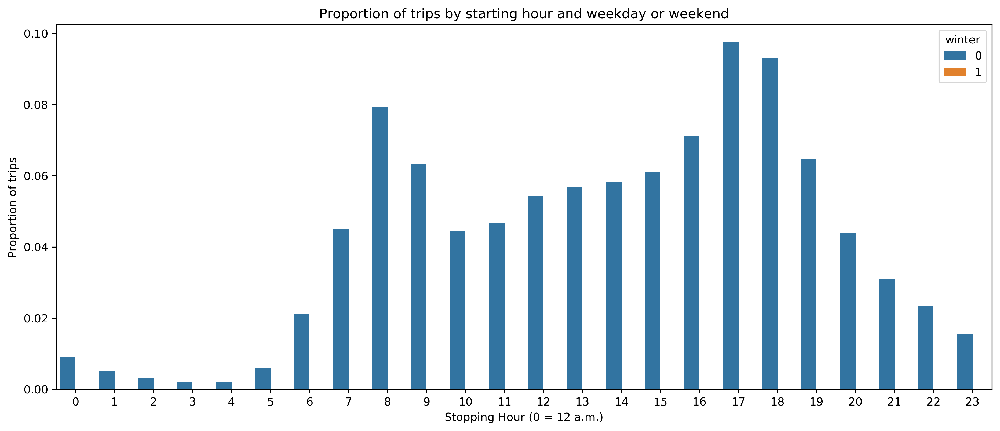

In [629]:
sns.barplot(x = 'start_hour', y = 'proportion', hue = 'winter', data = winter_df)
plt.xlabel('Stopping Hour (0 = 12 a.m.)')
plt.ylabel('Proportion of trips')
plt.title('Proportion of trips by starting hour and weekday or weekend')